In [32]:
!pip install -q efficientnet
!pip install kaggle


In [33]:
import os
import gc
import re

import cv2
import math
import numpy as np
import scipy as sp
import pandas as pd

import tensorflow as tf
from IPython.display import SVG
import efficientnet.tfkeras as efn
from keras.utils import plot_model
import tensorflow.keras.layers as L
from keras.utils import model_to_dot
import tensorflow.keras.backend as K
from tensorflow.keras.models import Model
from tensorflow.keras.applications import DenseNet121

import seaborn as sns
from tqdm import tqdm
import matplotlib.cm as cm
from sklearn import metrics
import matplotlib.pyplot as plt
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split

tqdm.pandas()
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots

np.random.seed(0)
tf.random.set_seed(0)

import warnings
warnings.filterwarnings("ignore")

In [34]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [35]:
base_dir = '/content/drive/MyDrive/Colab Notebooks/Kaggle'

SAMPLE_LEN = 101


image_path = os.path.join(base_dir, 'plant-pathology-2020-fgvc7/images/')
train_path = os.path.join(base_dir, 'plant-pathology-2020-fgvc7/train.csv')
test_path = os.path.join(base_dir, 'plant-pathology-2020-fgvc7/test.csv')
sub_path = os.path.join(base_dir, 'plant-pathology-2020-fgvc7/sample_submission.csv')

sub = pd.read_csv(sub_path)
test_data = pd.read_csv(test_path)
train_data = pd.read_csv(train_path)

In [36]:
train_data.head()

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0


In [37]:
test_data.head()

,image_id
0,Test_0
1,Test_1
2,Test_2
3,Test_3
4,Test_4


In [38]:
sub.head()

,image_id,healthy,multiple_diseases,rust,scab
0,Test_0,0.25,0.25,0.25,0.25
1,Test_1,0.25,0.25,0.25,0.25
2,Test_2,0.25,0.25,0.25,0.25
3,Test_3,0.25,0.25,0.25,0.25
4,Test_4,0.25,0.25,0.25,0.25


In [39]:
def load_image(image_id):
    file_path = image_id + ".jpg"
    image = cv2.imread(image_path + file_path)
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

#train_images = train_data["image_id"][:SAMPLE_LEN].progress_apply(load_image)
train_images = train_data["image_id"][:].progress_apply(load_image)

100%|██████████| 1821/1821 [00:38<00:00, 47.35it/s]


# Visual

In [40]:
fig = px.imshow(cv2.resize(train_images[0], (205, 136)))
fig.show()

In [41]:
def visualize_leaves(cond_cols=["healthy"]):
    cond_list = []
    for col in cond_cols:
        if col == "healthy":
            cond_list.append("healthy==1")
        if col == "scab":
            cond_list.append("scab==1")
        if col == "rust":
            cond_list.append("rust==1")
        if col == "multiple_diseases":
            cond_list.append("multiple_diseases==1")

    data = train_data.loc[:100]
    for cond in cond_list:
        data = data.query(cond)

    images = train_images.loc[list(data.index)]
    cols, rows = 3, min([3, len(images)//3])

    fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(30, rows*20/3))
    for col in range(cols):
        for row in range(rows):
            ax[row, col].imshow(images.loc[images.index[row*2+col]])
    plt.show()


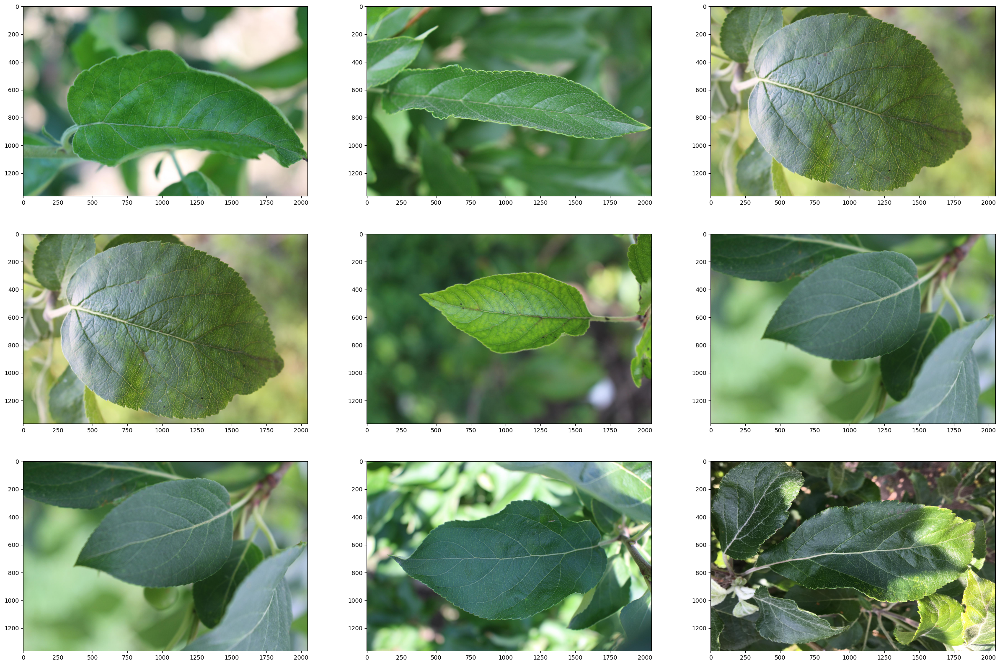

In [42]:
visualize_leaves(cond_cols=["healthy"])

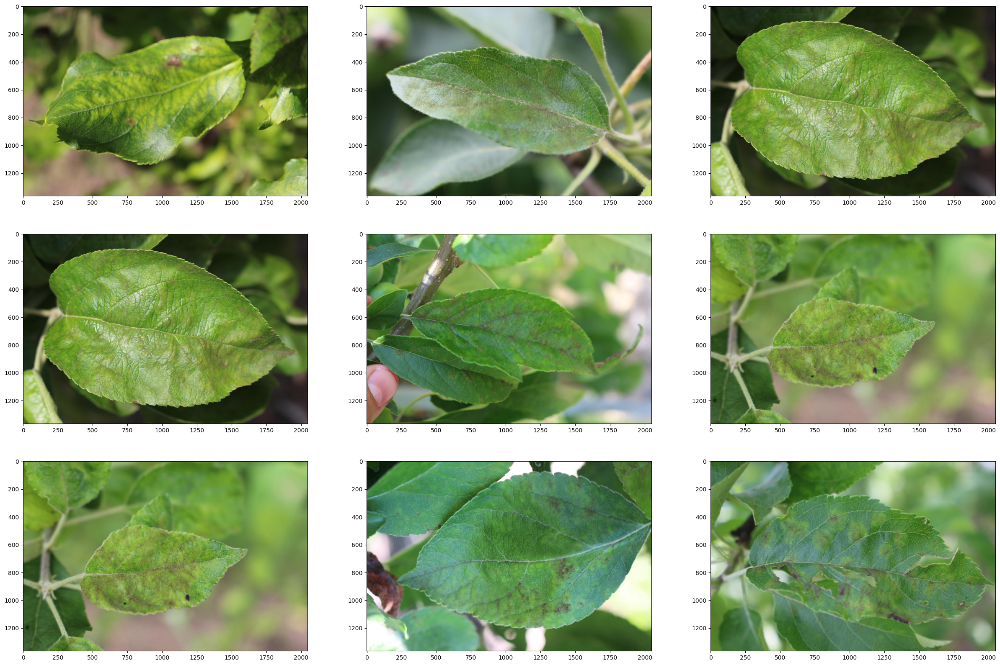

In [43]:
visualize_leaves(cond_cols=["scab"])

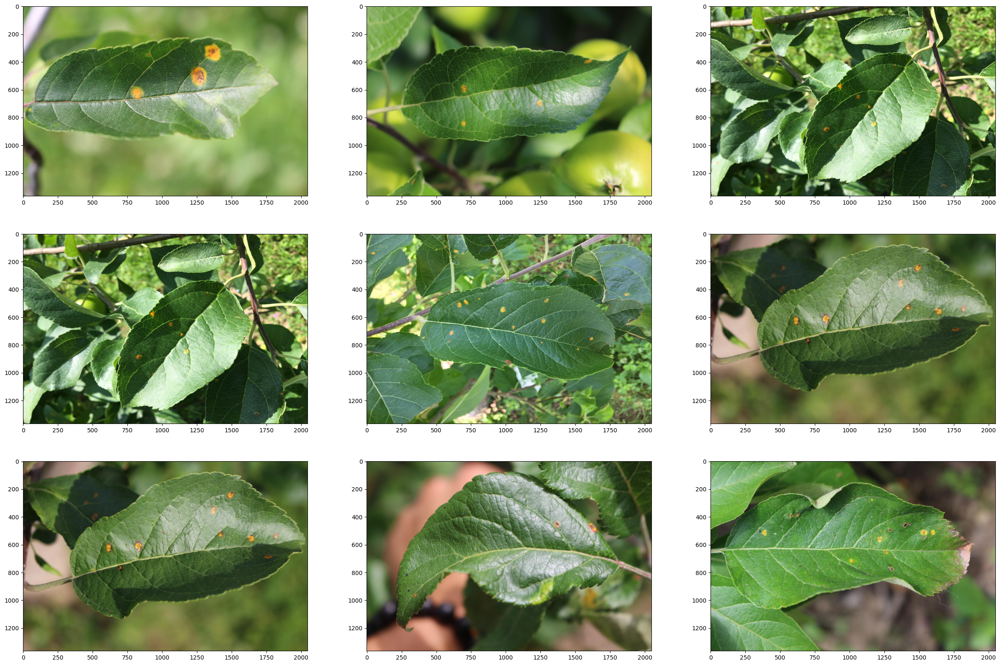

In [44]:
visualize_leaves(cond_cols=["rust"])

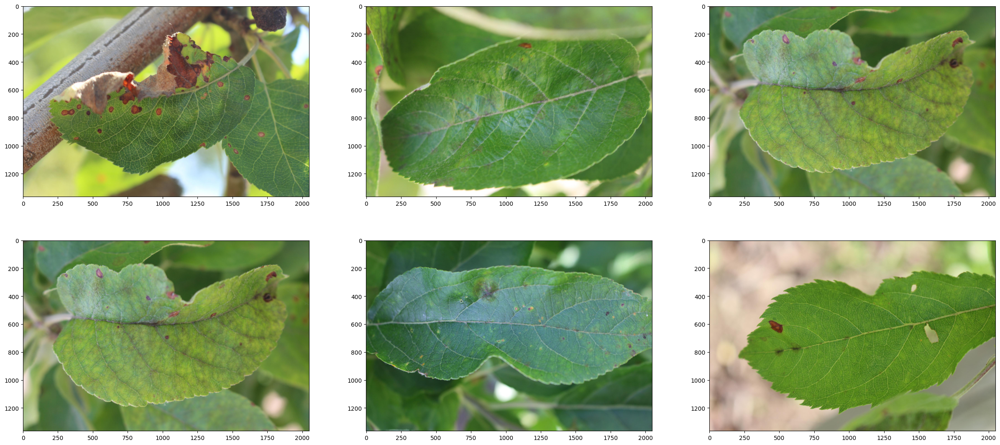

In [45]:
visualize_leaves(cond_cols=["multiple_diseases"])

In [46]:
LABEL_COLS = ['healthy', 'multiple_diseases', 'rust', 'scab']

# Tính toán số lượng mẫu cho mỗi nhãn
label_counts = train_data[LABEL_COLS].idxmax(axis=1).value_counts()

# Tạo biểu đồ cột
fig = go.Figure(data=[go.Bar(x=label_counts.index, y=label_counts.values)])

# Cập nhật layout cho biểu đồ
fig.update_layout(
    title_text='Label Distribution',
    xaxis_title='Labels',
    yaxis_title='Count',
    template='simple_white'
)

# Hiển thị biểu đồ
fig.show()

# Image processing and augmentation

In [47]:
def compare_images(img1, img2):
  fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
  ax[0].imshow(img1)
  ax[0].set_title('Original Image', fontsize=24)
  ax[1].imshow(img2)
  ax[1].set_title('Process Image', fontsize=24)
  plt.show()

## Canny edge detection

In [48]:
def crop_image_with_canny(img):
    emb_img = img.copy()
    height, width, channels = img.shape
    edges = cv2.Canny(img, 100, 255)
    edge_coors = []
    for i in range(edges.shape[0]):
        for j in range(edges.shape[1]):
            if edges[i][j] != 0:
                edge_coors.append((i, j))

    row_min = edge_coors[np.argsort([coor[0] for coor in edge_coors])[0]][0]
    row_max = edge_coors[np.argsort([coor[0] for coor in edge_coors])[-1]][0]
    col_min = edge_coors[np.argsort([coor[1] for coor in edge_coors])[0]][1]
    col_max = edge_coors[np.argsort([coor[1] for coor in edge_coors])[-1]][1]
    new_img = img[row_min:row_max, col_min:col_max]
    return new_img

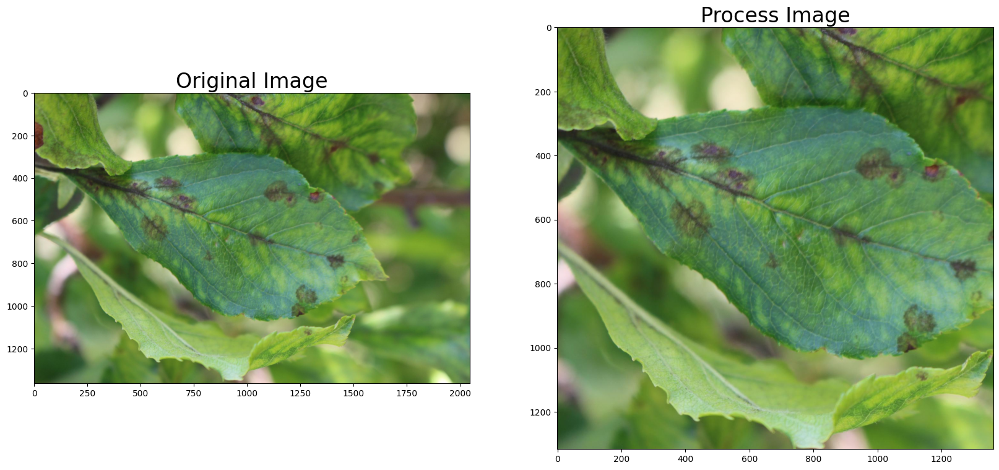

In [49]:
img = crop_image_with_canny(train_images[80])
compare_images(train_images[80], img)

## Vertical and horizontal

In [50]:
def data_augment(image, label=None):
    image = tf.image.random_flip_left_right(image)
    image = tf.image.random_flip_up_down(image)

    if label is None:
        return image
    else:
        return image, label

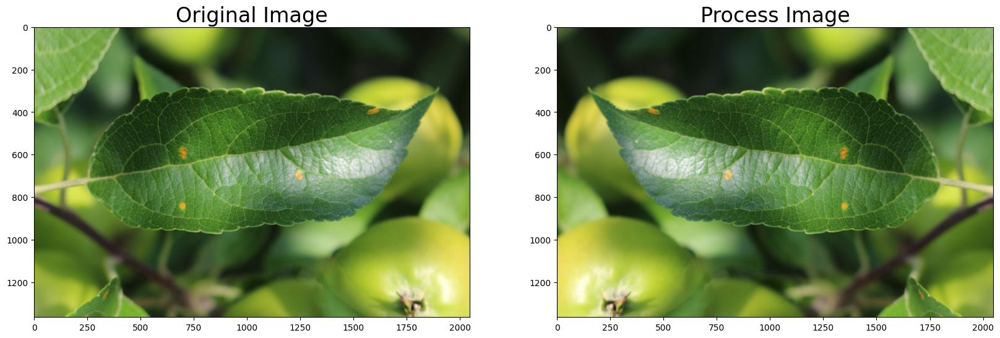

In [51]:
img = data_augment(train_images[10])
compare_images(train_images[10], img)

# Model

## Config TPU

In [52]:
AUTO = tf.data.experimental.AUTOTUNE
tpu = tf.distribute.cluster_resolver.TPUClusterResolver()

tf.config.experimental_connect_to_cluster(tpu)
tf.tpu.experimental.initialize_tpu_system(tpu)
strategy = tf.distribute.experimental.TPUStrategy(tpu)

BATCH_SIZE = 16 * strategy.num_replicas_in_sync


## Decode

In [53]:
def decode_image(filename, label=None, image_size=(512, 512)):
    bits = tf.io.read_file(filename)
    image = tf.image.decode_jpeg(bits, channels=3)
    image = tf.cast(image, tf.float32) / 255.0
    image = tf.image.resize(image, image_size)

    if label is None:
        return image
    else:
        return image, label

## Data

In [54]:
def format_path(st):
    return base_dir + '/plant-pathology-2020-fgvc7/images/' + st + '.jpg'

test_paths = test_data.image_id.apply(format_path).values
train_paths = train_data.image_id.apply(format_path).values

train_labels = np.float32(train_data.loc[:, 'healthy':'scab'].values)
train_paths, valid_paths, train_labels, valid_labels =\
train_test_split(train_paths, train_labels, test_size=0.15, random_state=2024)

In [55]:
train_dataset = (
    tf.data.Dataset
    .from_tensor_slices((train_paths, train_labels))
    .map(decode_image, num_parallel_calls=AUTO)
    .map(data_augment, num_parallel_calls=AUTO)
    .repeat()
    .shuffle(512)
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)

valid_dataset = (
    tf.data.Dataset
    .from_tensor_slices((valid_paths, valid_labels))
    .map(decode_image, num_parallel_calls=AUTO)
    .batch(BATCH_SIZE)
    .cache()
    .prefetch(AUTO)
)

test_dataset = (
    tf.data.Dataset
    .from_tensor_slices(test_paths)
    .map(decode_image, num_parallel_calls=AUTO)
    .batch(BATCH_SIZE)
)

## Hyperparameters

In [56]:
def build_lrfn(lr_start=0.00001, lr_max=0.00005,
               lr_min=0.00001, lr_rampup_epochs=5,
               lr_sustain_epochs=0, lr_exp_decay=.8):
    lr_max = lr_max * strategy.num_replicas_in_sync

    def lrfn(epoch):
        if epoch < lr_rampup_epochs:
            lr = (lr_max - lr_start) / lr_rampup_epochs * epoch + lr_start
        elif epoch < lr_rampup_epochs + lr_sustain_epochs:
            lr = lr_max
        else:
            lr = (lr_max - lr_min) *\
                 lr_exp_decay**(epoch - lr_rampup_epochs\
                                - lr_sustain_epochs) + lr_min
        return lr
    return lrfn



In [57]:
lrfn = build_lrfn()
STEPS_PER_EPOCH = train_labels.shape[0] // BATCH_SIZE
lr_schedule = tf.keras.callbacks.LearningRateScheduler(lrfn, verbose=1)

## Define model

In [58]:
with strategy.scope():
    model = tf.keras.Sequential([DenseNet121(input_shape=(512, 512, 3),
                                             weights='imagenet',
                                             include_top=False),
                                 L.GlobalAveragePooling2D(),
                                 L.Dense(train_labels.shape[1],
                                         activation='softmax')])

    model.compile(optimizer='adam',
                  loss = 'categorical_crossentropy',
                  metrics=['categorical_accuracy'])
    model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 densenet121 (Functional)    (None, 16, 16, 1024)      7037504   
                                                                 
 global_average_pooling2d_1  (None, 1024)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_1 (Dense)             (None, 4)                 4100      
                                                                 
Total params: 7041604 (26.86 MB)
Trainable params: 6957956 (26.54 MB)
Non-trainable params: 83648 (326.75 KB)
_________________________________________________________________


In [59]:
EPOCHS = 20
history = model.fit(train_dataset,
                    epochs=EPOCHS,
                    callbacks=[lr_schedule],
                    steps_per_epoch=STEPS_PER_EPOCH,
                    validation_data=valid_dataset)


Epoch 1: LearningRateScheduler setting learning rate to 1e-05.
Epoch 1/20
12/12 [==============================] - 152s 4s/step - loss: 1.4477 - categorical_accuracy: 0.3047 - val_loss: 1.5960 - val_categorical_accuracy: 0.1569 - lr: 1.0000e-05

Epoch 2: LearningRateScheduler setting learning rate to 8.8e-05.
Epoch 2/20
12/12 [==============================] - 11s 943ms/step - loss: 0.8195 - categorical_accuracy: 0.6953 - val_loss: 1.3423 - val_categorical_accuracy: 0.4708 - lr: 8.8000e-05

Epoch 3: LearningRateScheduler setting learning rate to 0.000166.
Epoch 3/20
12/12 [==============================] - 11s 957ms/step - loss: 0.3265 - categorical_accuracy: 0.8861 - val_loss: 1.9460 - val_categorical_accuracy: 0.4927 - lr: 1.6600e-04

Epoch 4: LearningRateScheduler setting learning rate to 0.000244.
Epoch 4/20
12/12 [==============================] - 11s 955ms/step - loss: 0.1880 - categorical_accuracy: 0.9355 - val_loss: 2.0957 - val_categorical_accuracy: 0.5255 - lr: 2.4400e-04

E

## Visualize results

In [60]:
def display_training_curves(training, validation, yaxis):
    if yaxis == "loss":
        ylabel = "Loss"
        title = "Loss vs. Epochs"
    else:
        ylabel = "Accuracy"
        title = "Accuracy vs. Epochs"

    fig = go.Figure()

    fig.add_trace(
        go.Scatter(x=np.arange(1, EPOCHS+1), mode='lines+markers', y=training, marker=dict(color="dodgerblue"),
               name="Train"))

    fig.add_trace(
        go.Scatter(x=np.arange(1, EPOCHS+1), mode='lines+markers', y=validation, marker=dict(color="darkorange"),
               name="Val"))

    fig.update_layout(title_text=title, yaxis_title=ylabel, xaxis_title="Epochs", template="plotly_white")
    fig.show()

In [61]:
display_training_curves(
    history.history['categorical_accuracy'],
    history.history['val_categorical_accuracy'],
    'accuracy')

# Predict submission

In [62]:
pred = model.predict(test_dataset, verbose=1)
sub.loc[:, 'healthy':] = pred
sub.to_csv('submission_dnn.csv', index=False)
sub.head()

15/15 [==============================] - 37s 1s/step


,image_id,healthy,multiple_diseases,rust,scab
0,Test_0,3.446689e-05,0.004164,9.957952e-01,6.680970e-06
1,Test_1,2.060448e-03,0.019146,9.781237e-01,6.694049e-04
2,Test_2,5.665331e-07,0.000059,4.088040e-07,9.999397e-01
3,Test_3,9.999474e-01,0.000004,4.648862e-05,1.758658e-06
4,Test_4,2.066974e-07,0.000036,9.999635e-01,6.828546e-07
